In [1]:
import warnings
warnings.filterwarnings('ignore')

import scanpy as sc
import anndata as ad
import pandas as pd

In [2]:
adata = sc.read_h5ad('../../results/integrate_scrna/integrated.h5ad')

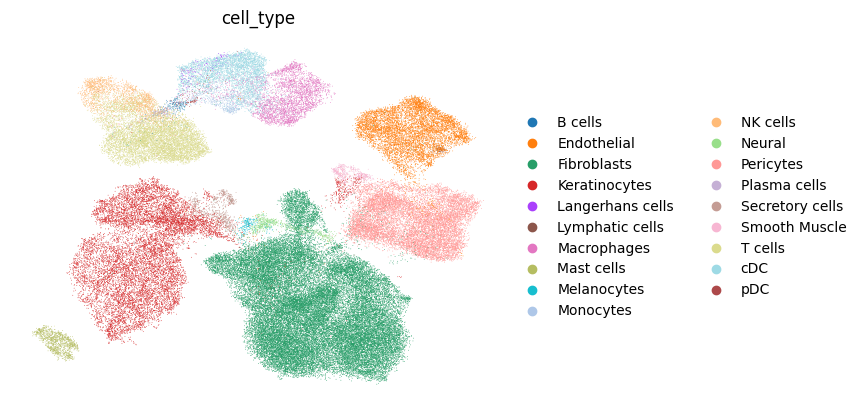

In [3]:
sc.pl.umap(adata, color=['cell_type'], frameon=False)

In [4]:
# find marker genes
adata.uns['log1p']['base'] = None
sc.tl.rank_genes_groups(adata, 'cell_type', method='wilcoxon')

In [5]:
result = adata.uns['rank_genes_groups']

In [6]:
result.keys()

dict_keys(['params', 'names', 'scores', 'pvals', 'pvals_adj', 'logfoldchanges'])

In [7]:
def get_top_markers(result, cell_type, p_value=0.05, top_n=5):
    df_genes = pd.DataFrame({'gene': result['names'][cell_type]})
    df_lfc = pd.DataFrame({'lfc': result['logfoldchanges'][cell_type]})
    df_pvalue = pd.DataFrame({'pvals_adj': result['pvals_adj'][cell_type]})
    
    df = pd.concat([df_genes, df_lfc, df_pvalue], axis=1).sort_values('lfc', ascending=False)
    
    # only keep positive markers
    df = df.loc[df['lfc'] > 0, :]
    
    df = df.head(top_n)
    
    return(df)

B cells


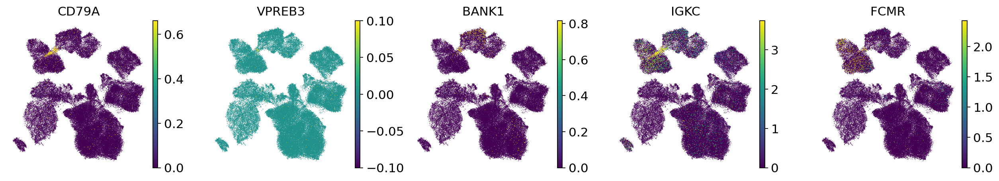

Endothelial


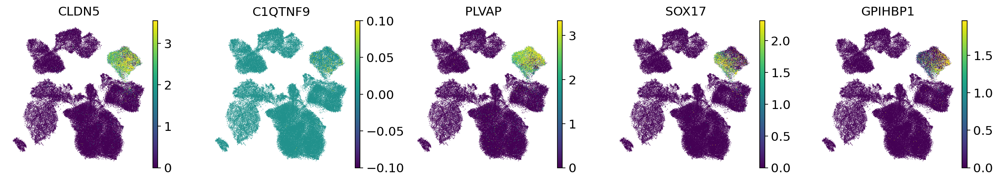

Fibroblasts


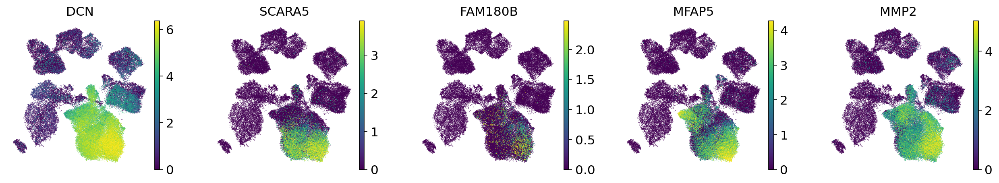

Keratinocytes


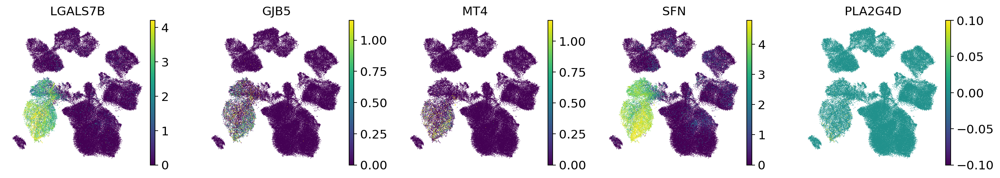

Langerhans cells


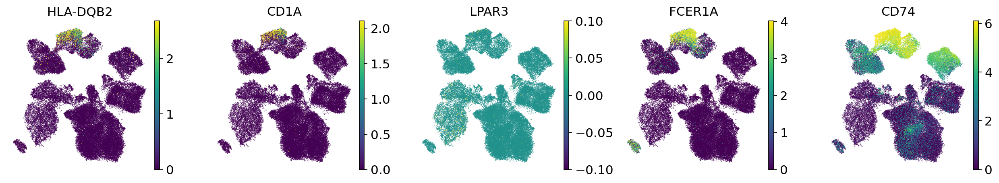

Lymphatic cells


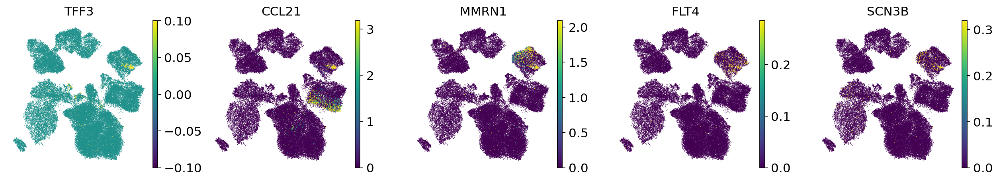

Macrophages


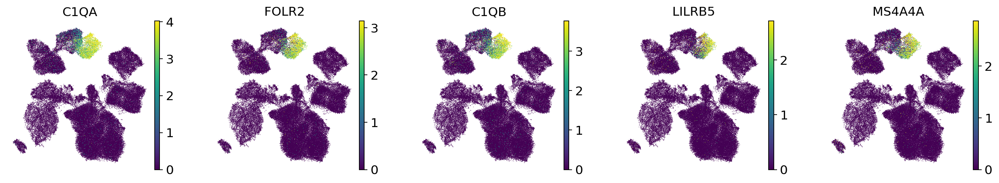

Mast cells


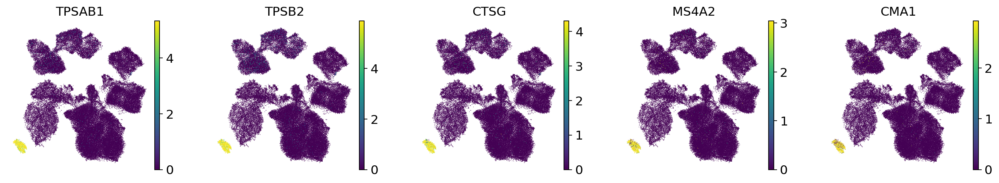

Melanocytes


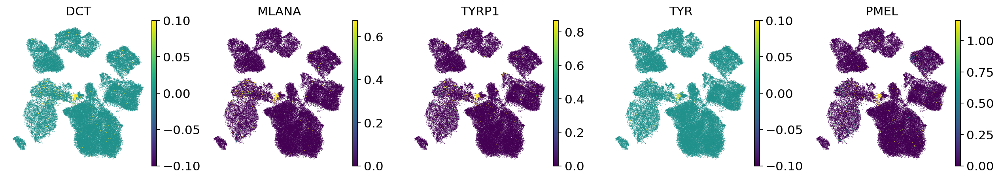

Monocytes


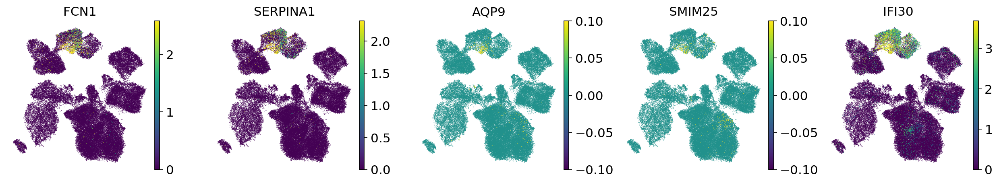

NK cells


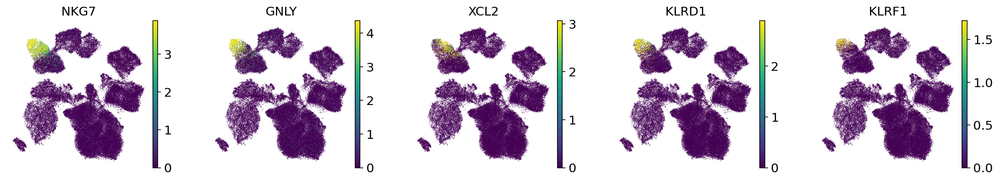

Neural


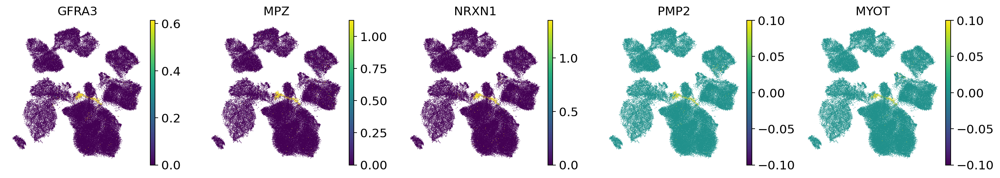

Pericytes


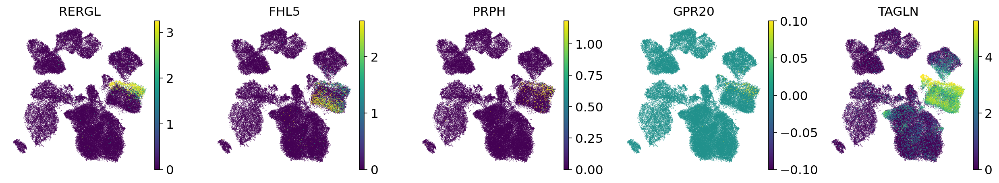

Plasma cells


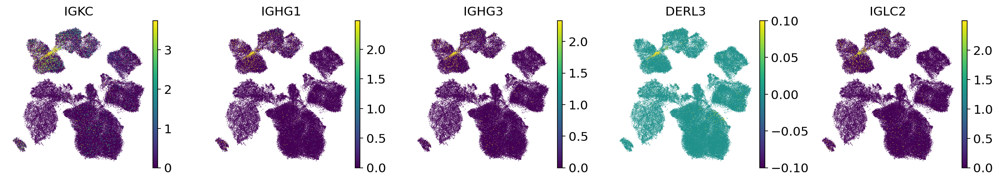

Secretory cells


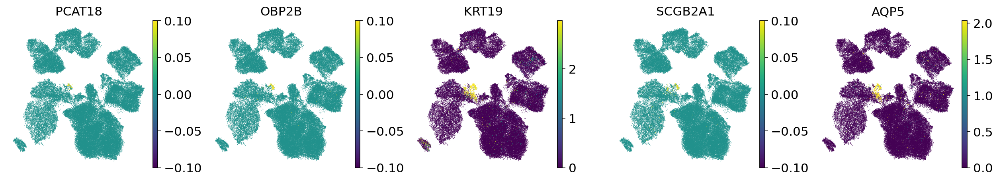

Smooth Muscle


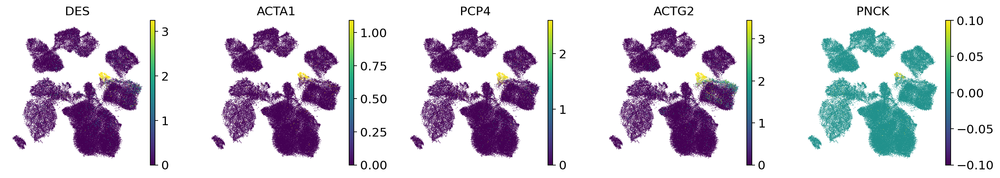

T cells


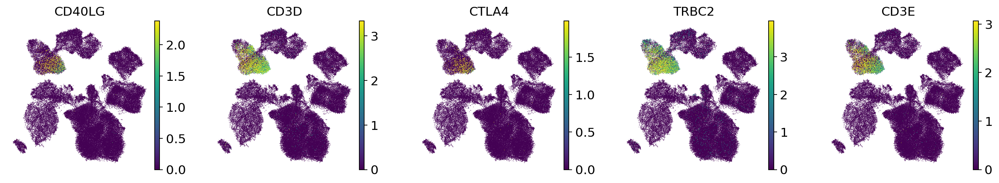

cDC


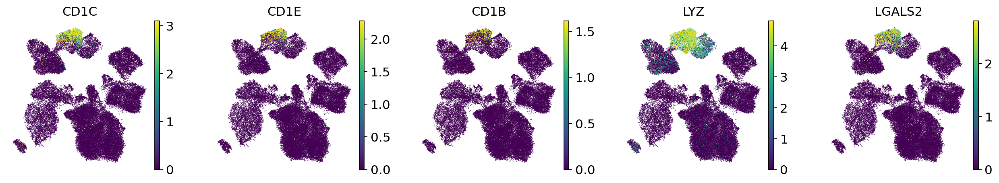

pDC


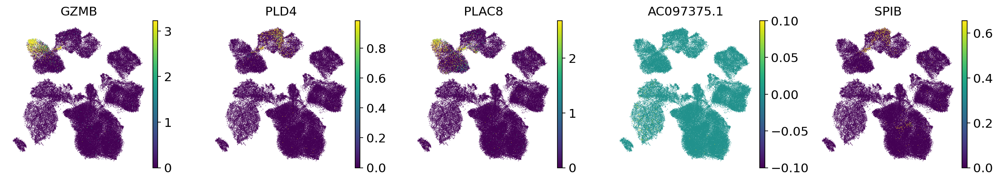

In [8]:
# plot top 5 genes for cell type
sc.set_figure_params(figsize=(3, 3))

for cell_type in result['names'].dtype.names:
    print(cell_type)
    
    # get top 5 markers based on log fold change
    df = get_top_markers(result, cell_type)
    
    sc.pl.umap(adata, color=df['gene'], vmax='p99.5', vmin='p0.5', frameon=False, ncols=5)